In [1]:
from math import pi
import numpy as np
from scipy import signal 
import matplotlib.pyplot as plt
import wavio
import IPython
import random

In [2]:
def P2R(A, phi):
    return A * ( np.cos(phi) + np.sin(phi) * 1j )

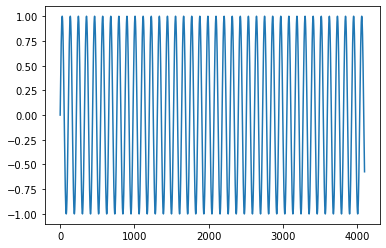

In [3]:
fs = 48000
length = 4096

f = 440.7

time = np.arange(length)
xn = np.sin(2 * np.pi * f * ( time / fs)) 

plt.plot(xn)
plt.show()

wavio.write("xn.wav", np.tile(xn, 40), fs, sampwidth=3)
IPython.display.display(IPython.display.Audio("xn.wav", rate=fs))

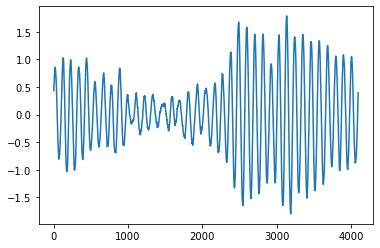

In [4]:
fftSize = length
Sustain = np.fft.fft(xn, fftSize)

randomTemp = np.random.rand(int(fftSize/2 - 1)) * 2 * np.pi - np.pi
randomPhase = np.concatenate(([0], randomTemp, [0], -np.flipud(randomTemp)), axis=0)

LongSustain = P2R(np.abs(Sustain), randomPhase)
longSustain = np.fft.ifft(LongSustain)

plt.plot(longSustain.real)
plt.show()

wavio.write("longSustain.wav", np.tile(longSustain.real, 40), fs, sampwidth=3)
IPython.display.display(IPython.display.Audio("longSustain.wav", rate=fs))

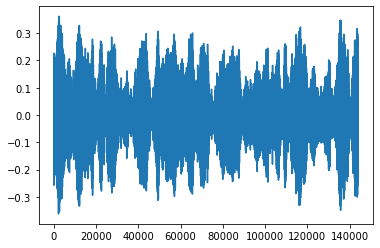

In [5]:
fftSize = fs * 3
Sustain = np.fft.fft(xn, fftSize)

randomTemp = np.random.rand(int(fftSize/2 - 1)) * 2 * np.pi - np.pi
randomPhase = np.concatenate(([0], randomTemp, [0], -np.flipud(randomTemp)), axis=0)

LongSustain = P2R(np.abs(Sustain), randomPhase)
longSustain = np.fft.ifft(LongSustain)

plt.plot(longSustain.real)
plt.show()

wavio.write("longSustainZeroPadding.wav", np.tile(longSustain.real, 40), fs, sampwidth=3)
IPython.display.display(IPython.display.Audio("longSustainZeroPadding.wav", rate=fs))

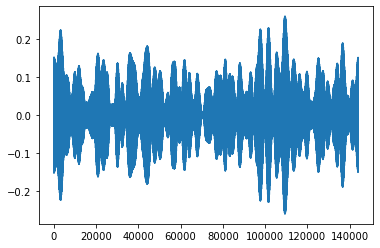

In [6]:
windowedSustain = xn * signal.windows.hann(len(xn))

fftSize = fs * 3
Sustain = np.fft.fft(windowedSustain, fftSize)

randomTemp = np.random.rand(int(fftSize/2 - 1)) * 2 * np.pi - np.pi
randomPhase = np.concatenate(([0], randomTemp, [0], -np.flipud(randomTemp)), axis=0)

LongSustain = P2R(np.abs(Sustain), randomPhase)
longSustain = np.fft.ifft(LongSustain)

plt.plot(longSustain.real)
plt.show()

wavio.write("longSustainPaddingWindow.wav", np.tile(longSustain.real, 40), fs, sampwidth=3)
IPython.display.display(IPython.display.Audio("longSustainPaddingWindow.wav", rate=fs))